# We begin by importing the required modules and datasets

In [1]:
import pandas as pd
import sqlite3 
import seaborn as sns

In [2]:
!pip3 install ipython-sql

DEPRECATION: Loading egg at /Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/jupyter-1.0.0-py3.11.egg is deprecated. pip 24.3 will enforce this behaviour change. A possible replacement is to use pip for package installation. Discussion can be found at https://github.com/pypa/pip/issues/12330

[notice] A new release of pip is available: 24.2 -> 25.0.1
[notice] To update, run: pip install --upgrade pip


In [3]:
cnn = sqlite3.connect('farm.db')

In [4]:
%load_ext sql

In [5]:
%sql sqlite:///farm.db

In [6]:
#We read all required CSV files and convert them so that we may perform sql operations

In [7]:
#We can see that in the cheese, coffee, egg, honey, milk, state_lookup, and yogurt
#datasets have a text data type when it should have an integer data type. 

#Also cheese, coffee, egg, honey, milk

In [8]:
cheese_production=pd.read_csv('cheese_production.csv')

In [9]:
cheese_production.to_sql('cheese_production',
                         cnn,
                        if_exists= 'replace')

7488

In [10]:
%%sql

Select *
From cheese_production

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,2023,APR,STATE,6.0,6,TOTAL,"208,807,000"
1,2023,APR,STATE,16.0,6,TOTAL,"86,452,000"
2,2023,APR,STATE,17.0,6,TOTAL,"5,068,000"
3,2023,APR,STATE,19.0,6,TOTAL,"31,512,000"
4,2023,APR,STATE,27.0,6,TOTAL,"69,728,000"
5,2023,APR,STATE,34.0,6,TOTAL,"4,889,000"
6,2023,APR,STATE,35.0,6,TOTAL,"79,038,000"
7,2023,APR,STATE,36.0,6,TOTAL,"66,256,000"
8,2023,APR,STATE,39.0,6,TOTAL,"20,510,000"
9,2023,APR,STATE,None,6,TOTAL,"215,206,000"


In [11]:
result = %sql Select * From cheese_production

cheese_production = result.DataFrame()

 * sqlite:///farm.db
Done.


In [12]:
cheese_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,0,2023,APR,STATE,6.0,6,TOTAL,"208,807,000"
1,1,2023,APR,STATE,16.0,6,TOTAL,"86,452,000"
2,2,2023,APR,STATE,17.0,6,TOTAL,"5,068,000"
3,3,2023,APR,STATE,19.0,6,TOTAL,"31,512,000"
4,4,2023,APR,STATE,27.0,6,TOTAL,"69,728,000"


In [13]:
cheese_production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7488 entries, 0 to 7487
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   index         7488 non-null   int64  
 1   Year          7488 non-null   int64  
 2   Period        7488 non-null   object 
 3   Geo_Level     7488 non-null   object 
 4   State_ANSI    7035 non-null   float64
 5   Commodity_ID  7488 non-null   int64  
 6   Domain        7488 non-null   object 
 7   Value         7488 non-null   object 
dtypes: float64(1), int64(3), object(4)
memory usage: 468.1+ KB


In [14]:
cheese_production.nunique()

index           7488
Year              54
Period            13
Geo_Level          1
State_ANSI        36
Commodity_ID       1
Domain             1
Value           7091
dtype: int64

In [15]:
cheese_production[cheese_production.duplicated()]

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value


In [16]:
cheese_production.isna().sum()

index             0
Year              0
Period            0
Geo_Level         0
State_ANSI      453
Commodity_ID      0
Domain            0
Value             0
dtype: int64

In [17]:
cheese_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,7488.0,3743.500000,2161.743741,0.0,1871.75,3743.5,5615.25,7487.0
Year,7488.0,2002.686966,11.857623,1970.0,1994.00,2002.0,2013.00,2023.0
State_ANSI,7035.0,32.914854,14.080630,1.0,19.00,35.0,46.00,55.0
Commodity_ID,7488.0,6.000000,0.000000,6.0,6.00,6.0,6.00,6.0


In [18]:
cheese_production['Value']= pd.to_numeric(cheese_production['Value'].str.replace(',',''), errors = 'coerce')

In [19]:
cheese_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,0,2023,APR,STATE,6.0,6,TOTAL,208807000.0
1,1,2023,APR,STATE,16.0,6,TOTAL,86452000.0
2,2,2023,APR,STATE,17.0,6,TOTAL,5068000.0
3,3,2023,APR,STATE,19.0,6,TOTAL,31512000.0
4,4,2023,APR,STATE,27.0,6,TOTAL,69728000.0


In [20]:
cheese_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,7488.0,3.743500e+03,2.161744e+03,0.0,1871.75,3743.5,5615.25,7.487000e+03
Year,7488.0,2.002687e+03,1.185762e+01,1970.0,1994.00,2002.0,2013.00,2.023000e+03
State_ANSI,7035.0,3.291485e+01,1.408063e+01,1.0,19.00,35.0,46.00,5.500000e+01
Commodity_ID,7488.0,6.000000e+00,0.000000e+00,6.0,6.00,6.0,6.00,6.000000e+00
Value,7486.0,9.612886e+07,2.631731e+08,26000.0,10258750.00,30334000.0,75192250.00,3.520083e+09


In [21]:
pd.set_option('display.float_format', '{:,.0f}'.format)

In [22]:
cheese_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"7,488","3,744","2,162",0,"1,872","3,744","5,615","7,487"
Year,"7,488","2,003",12,"1,970","1,994","2,002","2,013","2,023"
State_ANSI,"7,035",33,14,1,19,35,46,55
Commodity_ID,"7,488",6,0,6,6,6,6,6
Value,"7,486","96,128,856","263,173,144","26,000","10,258,750","30,334,000","75,192,250","3,520,083,000"


In [23]:
cheese_production.to_sql('cheese_production', cnn, index=False, if_exists='replace')

7488

In [24]:
%%sql

Select Max(value) 
From cheese_production

 * sqlite:///farm.db
Done.


Max(value)
3520083000.0


In [25]:
%%sql

Select AVG(value) 
From cheese_production

 * sqlite:///farm.db
Done.


AVG(value)
96128855.7306973


array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'Year'}>],
       [<Axes: title={'center': 'State_ANSI'}>,
        <Axes: title={'center': 'Commodity_ID'}>],
       [<Axes: title={'center': 'Value'}>, <Axes: >]], dtype=object)

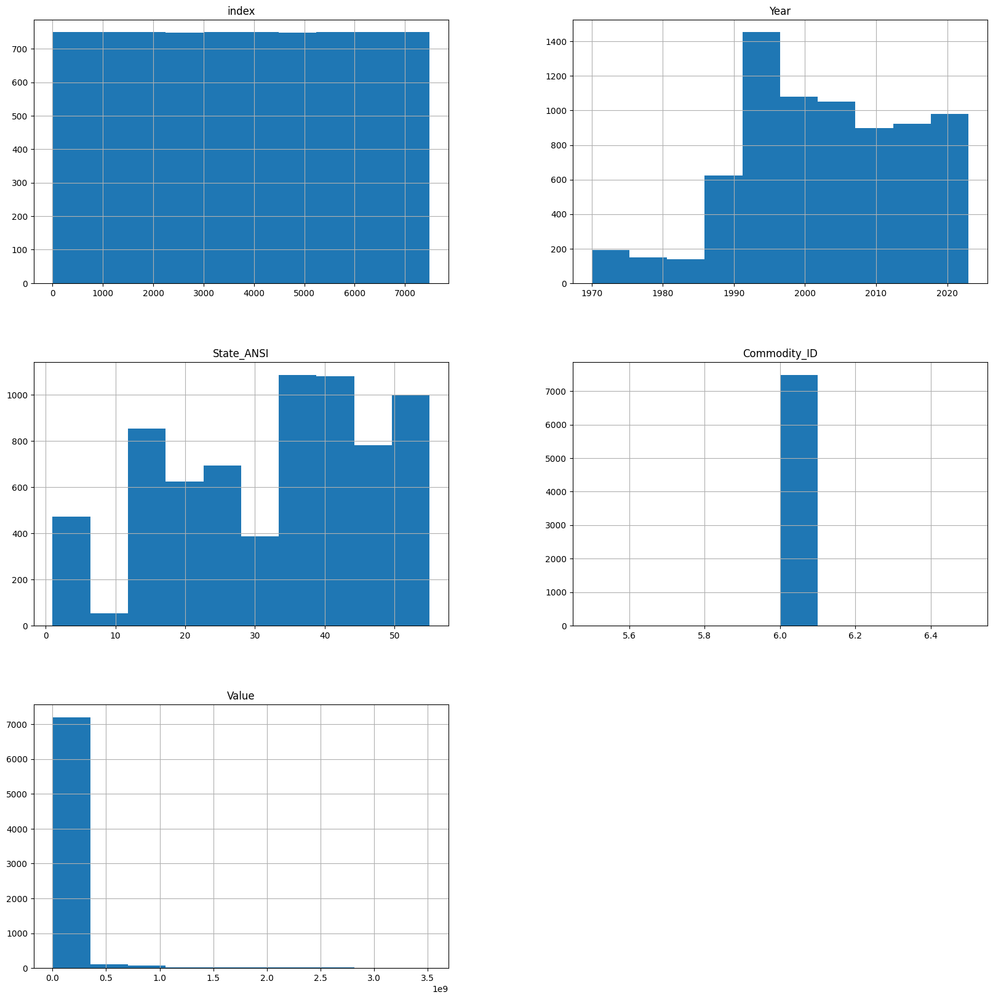

In [26]:
cheese_production.hist(figsize=(20,20))

In [27]:
cheese_production[['Value', 'State_ANSI', 'Year']].sort_values(by='Value', ascending=False)

,Value,State_ANSI,Year
237,"3,520,083,000",55,2022
419,"3,492,789,000",55,2021
978,"3,422,961,000",55,2018
588,"3,389,620,000",55,2020
1173,"3,376,769,000",55,2017
...,...,...,...
5890,"35,000",8,1993
5912,"32,000",8,1993
6022,"26,000",8,1993
1546,NaN,41,2015


<Axes: >

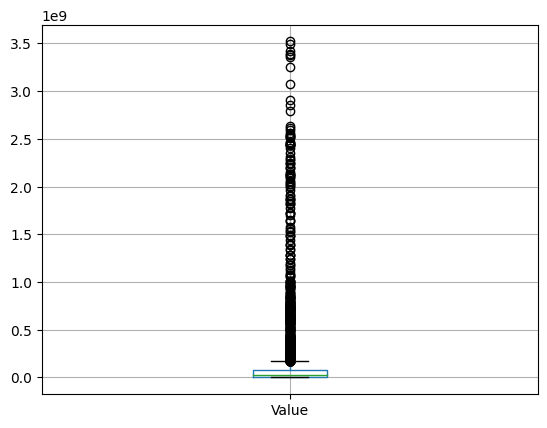

In [28]:
cheese_production.boxplot('Value')

In [29]:
%%sql

PRAGMA table_info(cheese_production);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,Year,INTEGER,0,None,0
2,Period,TEXT,0,None,0
3,Geo_Level,TEXT,0,None,0
4,State_ANSI,REAL,0,None,0
5,Commodity_ID,INTEGER,0,None,0
6,Domain,TEXT,0,None,0
7,Value,REAL,0,None,0


In [30]:
%%sql

Select * 
From cheese_production
Where Value > 2200000000

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
224,2022,YEAR,STATE,6.0,6,TOTAL,2460538000.0
233,2022,YEAR,STATE,None,6,TOTAL,2558953000.0
237,2022,YEAR,STATE,55.0,6,TOTAL,3520083000.0
406,2021,YEAR,STATE,6.0,6,TOTAL,2438397000.0
415,2021,YEAR,STATE,None,6,TOTAL,2439622000.0
419,2021,YEAR,STATE,55.0,6,TOTAL,3492789000.0
576,2020,YEAR,STATE,6.0,6,TOTAL,2434870000.0
585,2020,YEAR,STATE,None,6,TOTAL,2533667000.0
588,2020,YEAR,STATE,55.0,6,TOTAL,3389620000.0
769,2019,YEAR,STATE,6.0,6,TOTAL,2542827000.0


In [31]:
%%sql

UPDATE cheese_production 
SET value = REPLACE(value, ',', '')

 * sqlite:///farm.db
7488 rows affected.


[]

In [32]:
%%sql

ALTER TABLE cheese_production
ADD Value2 int(32)


 * sqlite:///farm.db
Done.


[]

In [33]:
%%sql

Update cheese_production
SET Value2 = Value

 * sqlite:///farm.db
7488 rows affected.


[]

In [34]:
%%sql

ALTER TABLE cheese_production
DROP COLUMN Value

 * sqlite:///farm.db
Done.


[]

In [35]:
%%sql

Select *
From cheese_production

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value2
0,2023,APR,STATE,6.0,6,TOTAL,208807000
1,2023,APR,STATE,16.0,6,TOTAL,86452000
2,2023,APR,STATE,17.0,6,TOTAL,5068000
3,2023,APR,STATE,19.0,6,TOTAL,31512000
4,2023,APR,STATE,27.0,6,TOTAL,69728000
5,2023,APR,STATE,34.0,6,TOTAL,4889000
6,2023,APR,STATE,35.0,6,TOTAL,79038000
7,2023,APR,STATE,36.0,6,TOTAL,66256000
8,2023,APR,STATE,39.0,6,TOTAL,20510000
9,2023,APR,STATE,None,6,TOTAL,215206000


In [36]:
%%sql

Select Count(State_ANSI)
From cheese_production
Where State_ANSI is not null

 * sqlite:///farm.db
Done.


Count(State_ANSI)
7035


In [37]:
#Note We may have to rename the column but sqlite3 doesn't offer a single command code that will rename columns
#We will have to copy the table with the columns name and rename it in a method similar to changing the data type

In [41]:
%%sql

Select (Value2)
From cheese_production
Where Value2 is null

 * sqlite:///farm.db
Done.


Value2
None
None


# Coffee Production

In [39]:
coffee_production=pd.read_csv('coffee_production.csv')

In [40]:
coffee_production.to_sql('coffee_production',
                         cnn,
                        if_exists= 'replace')

71

In [41]:
%%sql

Select *
From coffee_production

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value
0,2016,YEAR,STATE,15,1,"5,400,000"
1,2015,YEAR,STATE,15,1,"6,600,000"
2,2014,YEAR,STATE,15,1,"7,500,000"
3,2013,YEAR,STATE,15,1,"8,400,000"
4,2012,YEAR,STATE,15,1,"7,000,000"
5,2011,YEAR,STATE,15,1,"7,600,000"
6,2010,YEAR,STATE,15,1,"8,800,000"
7,2009,YEAR,STATE,15,1,"8,700,000"
8,2008,YEAR,STATE,15,1,"8,700,000"
9,2007,YEAR,STATE,15,1,"7,500,000"


In [42]:
result1 = %sql Select * From coffee_production
coffee_production = result1.DataFrame()

 * sqlite:///farm.db
Done.


In [43]:
coffee_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value
0,0,2016,YEAR,STATE,15,1,"5,400,000"
1,1,2015,YEAR,STATE,15,1,"6,600,000"
2,2,2014,YEAR,STATE,15,1,"7,500,000"
3,3,2013,YEAR,STATE,15,1,"8,400,000"
4,4,2012,YEAR,STATE,15,1,"7,000,000"


In [44]:
coffee_production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 71 entries, 0 to 70
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   index         71 non-null     int64 
 1   Year          71 non-null     int64 
 2   Period        71 non-null     object
 3   Geo_Level     71 non-null     object
 4   State_ANSI    71 non-null     int64 
 5   Commodity_ID  71 non-null     int64 
 6   Value         71 non-null     object
dtypes: int64(4), object(3)
memory usage: 4.0+ KB


In [45]:
coffee_production.nunique()

index           71
Year            71
Period           1
Geo_Level        1
State_ANSI       1
Commodity_ID     1
Value           62
dtype: int64

In [46]:
coffee_production[coffee_production.duplicated()]

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value


In [47]:
coffee_production.isna().sum()

index           0
Year            0
Period          0
Geo_Level       0
State_ANSI      0
Commodity_ID    0
Value           0
dtype: int64

In [48]:
coffee_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,71,35,21,0,18,35,52,70
Year,71,"1,981",21,"1,946","1,964","1,981","1,998","2,016"
State_ANSI,71,15,0,15,15,15,15,15
Commodity_ID,71,1,0,1,1,1,1,1


In [49]:
coffee_production['Value']= pd.to_numeric(coffee_production['Value'].str.replace(',',''), errors = 'coerce')

In [50]:
coffee_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value
0,0,2016,YEAR,STATE,15,1,5400000
1,1,2015,YEAR,STATE,15,1,6600000
2,2,2014,YEAR,STATE,15,1,7500000
3,3,2013,YEAR,STATE,15,1,8400000
4,4,2012,YEAR,STATE,15,1,7000000


In [51]:
coffee_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,71,35,21,0,18,35,52,70
Year,71,"1,981",21,"1,946","1,964","1,981","1,998","2,016"
State_ANSI,71,15,0,15,15,15,15,15
Commodity_ID,71,1,0,1,1,1,1,1
Value,71,"6,495,873","3,683,441","990,000","2,915,000","7,000,000","8,719,000","18,496,000"


In [52]:
coffee_production.to_sql('coffee_production', cnn, index=False, if_exists='replace')

71

In [53]:
%%sql

Select AVG(Value)
From coffee_production

 * sqlite:///farm.db
Done.


AVG(Value)
6495873.23943662


array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'Year'}>],
       [<Axes: title={'center': 'State_ANSI'}>,
        <Axes: title={'center': 'Commodity_ID'}>],
       [<Axes: title={'center': 'Value'}>, <Axes: >]], dtype=object)

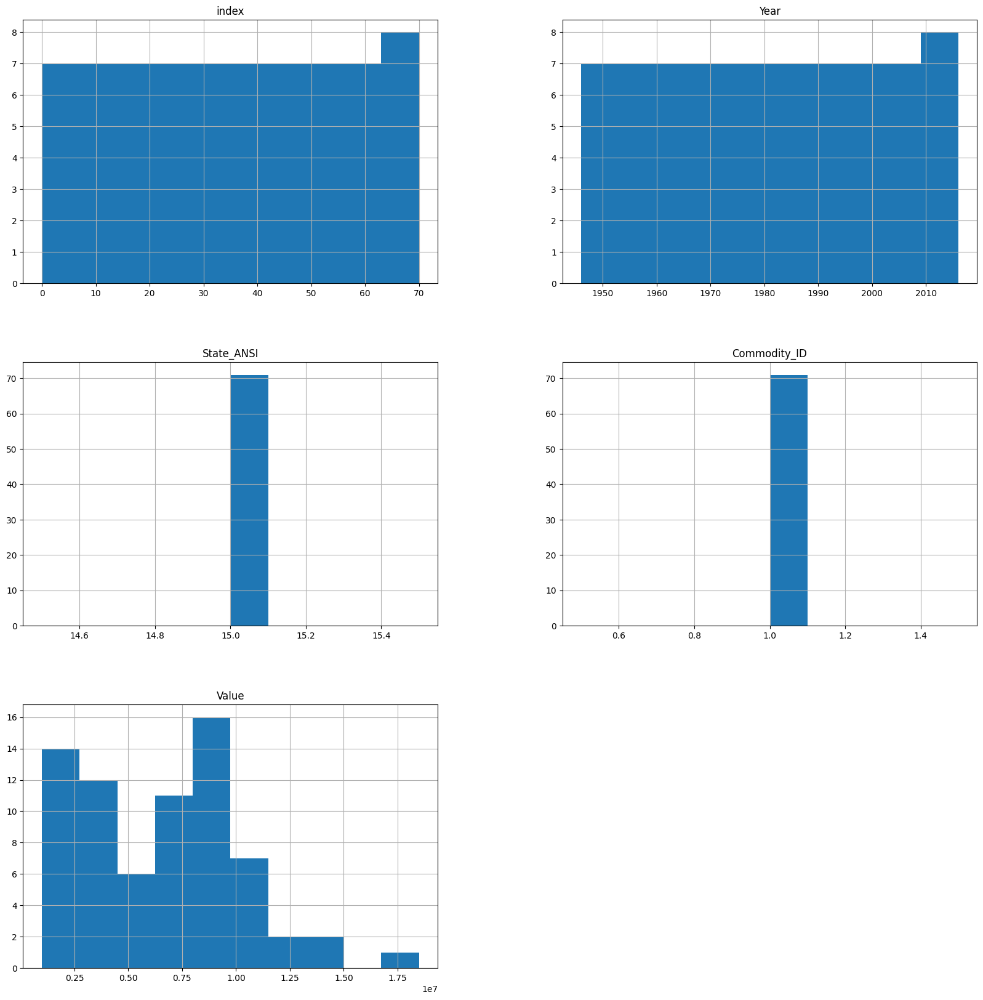

In [54]:
coffee_production.hist(figsize=(20,20))

In [55]:
coffee_production[['Value', 'State_ANSI', 'Year']].sort_values(by='Value', ascending=False)

,Value,State_ANSI,Year
59,18496000,15,1957
54,13392000,15,1962
56,13272000,15,1960
57,12999000,15,1959
62,12425000,15,1954
...,...,...,...
32,1750000,15,1984
38,1680000,15,1978
42,1540000,15,1974
36,1440000,15,1980


<Axes: >

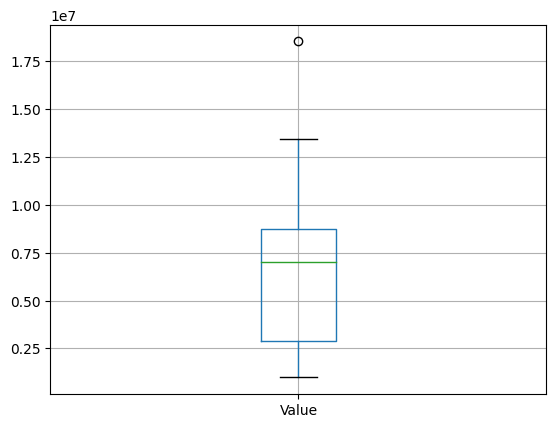

In [56]:
coffee_production.boxplot('Value')

In [57]:
%%sql

PRAGMA table_info(coffee_production);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,Year,INTEGER,0,None,0
2,Period,TEXT,0,None,0
3,Geo_Level,TEXT,0,None,0
4,State_ANSI,INTEGER,0,None,0
5,Commodity_ID,INTEGER,0,None,0
6,Value,INTEGER,0,None,0


In [58]:
%%sql

Select *
From coffee_production
WHERE Value is null

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value


# Egg Production

In [59]:
egg_production=pd.read_csv('egg_production.csv')

In [60]:
egg_production.to_sql('egg_production',
                         cnn,
                        if_exists= 'replace')

6327

In [61]:
%%sql 

Select * 

From egg_production


 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value
0,2023,APR,STATE,1.0,7,"224,100,000"
1,2023,APR,STATE,5.0,7,"319,000,000"
2,2023,APR,STATE,6.0,7,"271,300,000"
3,2023,APR,STATE,8.0,7,"52,200,000"
4,2023,APR,STATE,13.0,7,"437,800,000"
5,2023,APR,STATE,17.0,7,"162,500,000"
6,2023,APR,STATE,18.0,7,"891,300,000"
7,2023,APR,STATE,19.0,7,"1,149,000,000"
8,2023,APR,STATE,21.0,7,"122,400,000"
9,2023,APR,STATE,24.0,7,"54,500,000"


In [62]:
result2 = %sql Select * From egg_production
egg_production = result2.DataFrame()

 * sqlite:///farm.db
Done.


In [63]:
egg_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value
0,0,2023,APR,STATE,1,7,"224,100,000"
1,1,2023,APR,STATE,5,7,"319,000,000"
2,2,2023,APR,STATE,6,7,"271,300,000"
3,3,2023,APR,STATE,8,7,"52,200,000"
4,4,2023,APR,STATE,13,7,"437,800,000"


In [64]:
egg_production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6327 entries, 0 to 6326
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   index         6327 non-null   int64  
 1   Year          6327 non-null   int64  
 2   Period        6327 non-null   object 
 3   Geo_Level     6327 non-null   object 
 4   State_ANSI    6126 non-null   float64
 5   Commodity_ID  6327 non-null   int64  
 6   Value         6327 non-null   object 
dtypes: float64(1), int64(3), object(3)
memory usage: 346.1+ KB


In [65]:
egg_production.nunique()

index           6327
Year              80
Period            14
Geo_Level          1
State_ANSI        41
Commodity_ID       1
Value           3590
dtype: int64

In [66]:
egg_production[egg_production.duplicated()]

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value


In [67]:
egg_production.isna().sum()

index             0
Year              0
Period            0
Geo_Level         0
State_ANSI      201
Commodity_ID      0
Value             0
dtype: int64

In [68]:
egg_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"6,327","3,163","1,827",0,"1,582","3,163","4,744","6,326"
Year,"6,327","2,013",9,"1,944","2,011","2,015","2,019","2,023"
State_ANSI,"6,126",30,16,1,17,29,45,56
Commodity_ID,"6,327",7,0,7,7,7,7,7


In [69]:
egg_production['Value']= pd.to_numeric(egg_production['Value'].str.replace(',',''), errors = 'coerce')

In [70]:
egg_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Value
0,0,2023,APR,STATE,1,7,"224,100,000"
1,1,2023,APR,STATE,5,7,"319,000,000"
2,2,2023,APR,STATE,6,7,"271,300,000"
3,3,2023,APR,STATE,8,7,"52,200,000"
4,4,2023,APR,STATE,13,7,"437,800,000"


In [71]:
egg_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"6,327","3,163","1,827",0,"1,582","3,163","4,744","6,326"
Year,"6,327","2,013",9,"1,944","2,011","2,015","2,019","2,023"
State_ANSI,"6,126",30,16,1,17,29,45,56
Commodity_ID,"6,327",7,0,7,7,7,7,7
Value,"6,314","599,747,245","1,295,373,229","2,400,000","111,200,000","228,950,000","533,750,000","17,083,800,000"


In [72]:
egg_production.to_sql('egg_production', cnn, index=False, if_exists='replace')

6327

array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'Year'}>],
       [<Axes: title={'center': 'State_ANSI'}>,
        <Axes: title={'center': 'Commodity_ID'}>],
       [<Axes: title={'center': 'Value'}>, <Axes: >]], dtype=object)

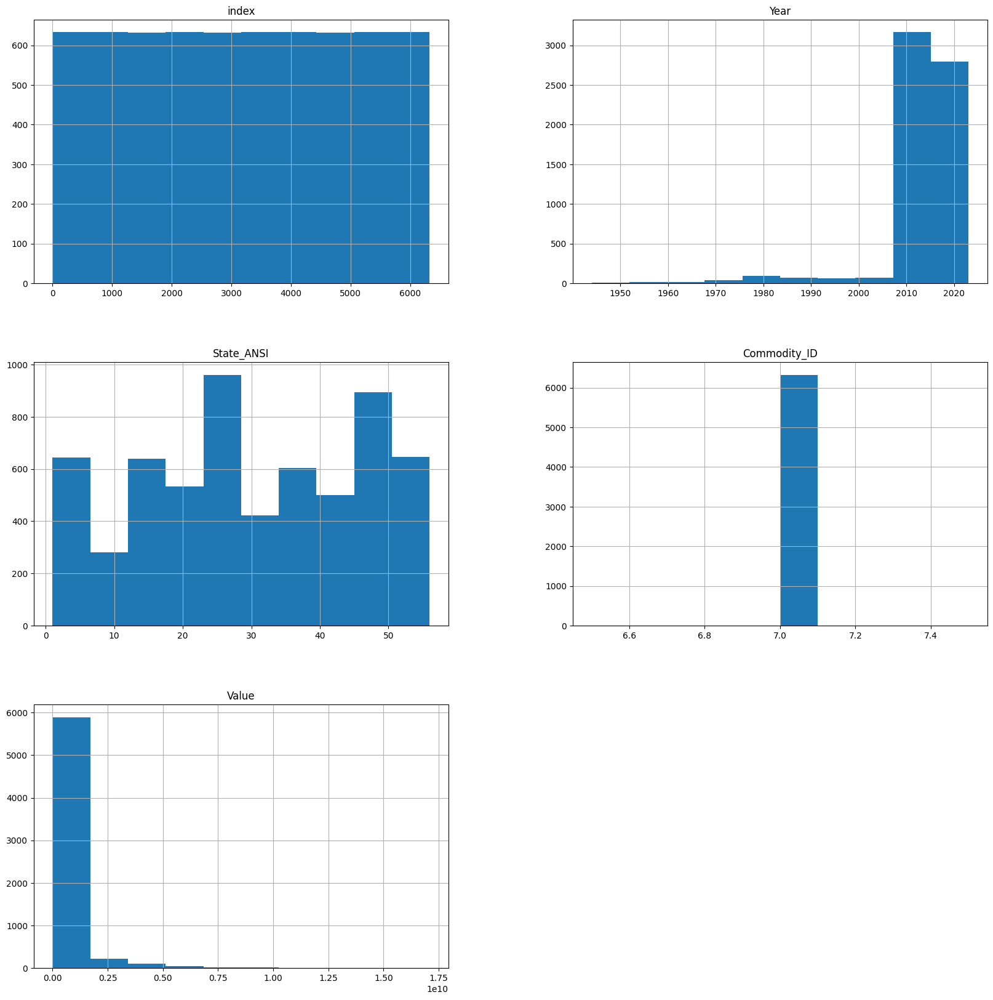

In [73]:
egg_production.hist(figsize=(20,20))

In [74]:
egg_production[['Value', 'State_ANSI', 'Year']].sort_values(by='Value', ascending=False)

,Value,State_ANSI,Year
1533,"17,083,800,000",19,2019
3398,"16,513,000,000",19,2014
2282,"16,155,200,000",19,2017
3787,"16,155,100,000",19,2013
1910,"16,119,300,000",19,2018
...,...,...,...
4629,NaN,15,2011
4660,NaN,15,2011
4691,NaN,15,2011
4722,NaN,15,2011


<Axes: >

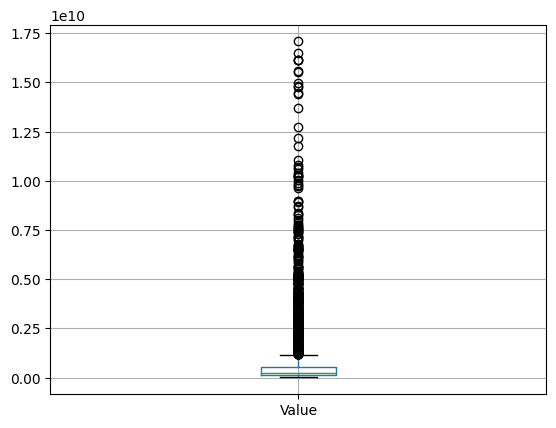

In [75]:
egg_production.boxplot('Value')

In [76]:
%%sql

PRAGMA table_info(egg_production);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,Year,INTEGER,0,None,0
2,Period,TEXT,0,None,0
3,Geo_Level,TEXT,0,None,0
4,State_ANSI,REAL,0,None,0
5,Commodity_ID,INTEGER,0,None,0
6,Value,REAL,0,None,0


# honey production

In [77]:
honey_production=pd.read_csv('honey_production.csv')

In [78]:
honey_production.to_sql('honey_production',
                         cnn,
                        if_exists= 'replace')

1559

In [79]:
%%sql 

Select * 
From honey_production

 * sqlite:///farm.db
Done.


index,Year,Geo_Level,State_ANSI,Commodity_ID,Value
0,2022,STATE,1.0,2,"400,000"
1,2022,STATE,4.0,2,"1,035,000"
2,2022,STATE,5.0,2,"1,120,000"
3,2022,STATE,6.0,2,"11,590,000"
4,2022,STATE,8.0,2,"1,302,000"
5,2022,STATE,12.0,2,"7,350,000"
6,2022,STATE,13.0,2,"3,296,000"
7,2022,STATE,16.0,2,"2,726,000"
8,2022,STATE,17.0,2,"470,000"
9,2022,STATE,18.0,2,"567,000"


In [80]:
result3 = %sql Select * From honey_production
honey_production = result3.DataFrame()


 * sqlite:///farm.db
Done.


In [81]:
honey_production.head()

,index,Year,Geo_Level,State_ANSI,Commodity_ID,Value
0,0,2022,STATE,1,2,"400,000"
1,1,2022,STATE,4,2,"1,035,000"
2,2,2022,STATE,5,2,"1,120,000"
3,3,2022,STATE,6,2,"11,590,000"
4,4,2022,STATE,8,2,"1,302,000"


In [82]:
honey_production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1559 entries, 0 to 1558
Data columns (total 6 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   index         1559 non-null   int64  
 1   Year          1559 non-null   int64  
 2   Geo_Level     1559 non-null   object 
 3   State_ANSI    1527 non-null   float64
 4   Commodity_ID  1559 non-null   int64  
 5   Value         1559 non-null   object 
dtypes: float64(1), int64(3), object(2)
memory usage: 73.2+ KB


In [83]:
honey_production.nunique()

index           1559
Year              36
Geo_Level          1
State_ANSI        49
Commodity_ID       1
Value           1068
dtype: int64

In [84]:
honey_production[honey_production.duplicated()]

,index,Year,Geo_Level,State_ANSI,Commodity_ID,Value


In [85]:
honey_production.isna().sum()

index            0
Year             0
Geo_Level        0
State_ANSI      32
Commodity_ID     0
Value            0
dtype: int64

In [86]:
honey_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"1,559",779,450,0,390,779,"1,168","1,558"
Year,"1,559","2,004",10,"1,987","1,995","2,004","2,013","2,022"
State_ANSI,"1,527",30,16,1,18,30,44,56
Commodity_ID,"1,559",2,0,2,2,2,2,2


In [87]:
honey_production['Value']= pd.to_numeric(honey_production['Value'].str.replace(',',''), errors = 'coerce')

In [88]:
honey_production.head()

,index,Year,Geo_Level,State_ANSI,Commodity_ID,Value
0,0,2022,STATE,1,2,400000
1,1,2022,STATE,4,2,1035000
2,2,2022,STATE,5,2,1120000
3,3,2022,STATE,6,2,11590000
4,4,2022,STATE,8,2,1302000


In [89]:
honey_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"1,559",779,450,0,390,779,"1,168","1,558"
Year,"1,559","2,004",10,"1,987","1,995","2,004","2,013","2,022"
State_ANSI,"1,527",30,16,1,18,30,44,56
Commodity_ID,"1,559",2,0,2,2,2,2,2
Value,"1,559","4,146,268","6,709,822","10,000","511,000","1,570,000","4,135,000","46,410,000"


In [90]:
honey_production.to_sql('honey_production', cnn, index=False, if_exists='replace')

1559

array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'Year'}>],
       [<Axes: title={'center': 'State_ANSI'}>,
        <Axes: title={'center': 'Commodity_ID'}>],
       [<Axes: title={'center': 'Value'}>, <Axes: >]], dtype=object)

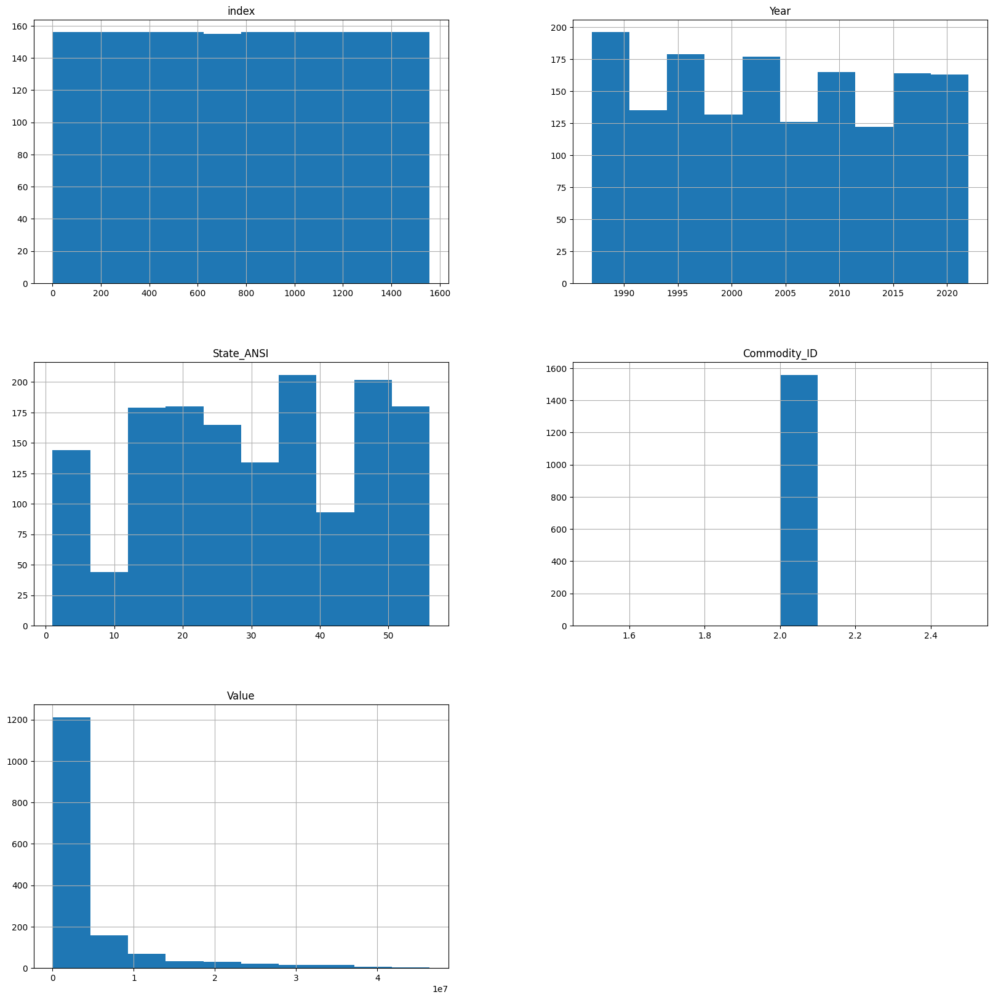

In [91]:
honey_production.hist(figsize=(20,20))

In [92]:
honey_production[['Value', 'State_ANSI', 'Year']].sort_values(by='Value', ascending=False)

,Value,State_ANSI,Year
516,46410000,38,2010
1231,45000000,6,1993
352,42140000,38,2014
188,39600000,38,2018
1141,39060000,6,1995
...,...,...,...
1400,31000,44,1990
1516,29000,10,1987
1467,26000,10,1988
1369,11000,10,1990


<Axes: >

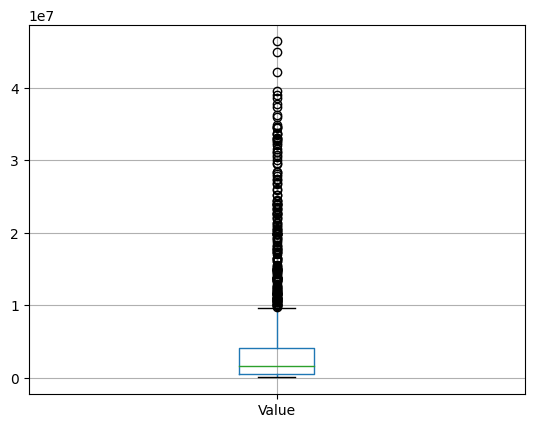

In [93]:
honey_production.boxplot('Value')

In [94]:
%%sql

PRAGMA table_info(honey_production);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,Year,INTEGER,0,None,0
2,Geo_Level,TEXT,0,None,0
3,State_ANSI,REAL,0,None,0
4,Commodity_ID,INTEGER,0,None,0
5,Value,INTEGER,0,None,0


# milk production

In [95]:
milk_production=pd.read_csv('milk_production.csv')

In [96]:
milk_production.to_sql('milk_production',
                         cnn,
                        if_exists= 'replace')

37638

In [97]:
%%sql 

Select * 

From milk_production

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,2023,APR,STATE,4.0,5,TOTAL,"428,000,000"
1,2023,APR,STATE,6.0,5,TOTAL,"3,543,000,000"
2,2023,APR,STATE,8.0,5,TOTAL,"444,000,000"
3,2023,APR,STATE,12.0,5,TOTAL,"166,000,000"
4,2023,APR,STATE,13.0,5,TOTAL,"180,000,000"
5,2023,APR,STATE,16.0,5,TOTAL,"1,408,000,000"
6,2023,APR,STATE,17.0,5,TOTAL,"147,000,000"
7,2023,APR,STATE,18.0,5,TOTAL,"380,000,000"
8,2023,APR,STATE,19.0,5,TOTAL,"494,000,000"
9,2023,APR,STATE,20.0,5,TOTAL,"360,000,000"


In [98]:
result4 = %sql Select * From milk_production
milk_production = result4.DataFrame()

 * sqlite:///farm.db
Done.


In [99]:
milk_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,0,2023,APR,STATE,4,5,TOTAL,"428,000,000"
1,1,2023,APR,STATE,6,5,TOTAL,"3,543,000,000"
2,2,2023,APR,STATE,8,5,TOTAL,"444,000,000"
3,3,2023,APR,STATE,12,5,TOTAL,"166,000,000"
4,4,2023,APR,STATE,13,5,TOTAL,"180,000,000"


In [100]:
milk_production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37638 entries, 0 to 37637
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   index         37638 non-null  int64  
 1   Year          37638 non-null  int64  
 2   Period        37638 non-null  object 
 3   Geo_Level     37638 non-null  object 
 4   State_ANSI    37634 non-null  float64
 5   Commodity_ID  37638 non-null  int64  
 6   Domain        37638 non-null  object 
 7   Value         37638 non-null  object 
dtypes: float64(1), int64(3), object(4)
memory usage: 2.3+ MB


In [101]:
milk_production.nunique()

index           37638
Year              100
Period             13
Geo_Level           1
State_ANSI         50
Commodity_ID        1
Domain              1
Value            4000
dtype: int64

In [102]:
milk_production[milk_production.duplicated()]

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value


In [103]:
milk_production.isna().sum()

index           0
Year            0
Period          0
Geo_Level       0
State_ANSI      4
Commodity_ID    0
Domain          0
Value           0
dtype: int64

In [104]:
milk_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"37,638","18,818","10,865",0,"9,409","18,818","28,228","37,637"
Year,"37,638","1,973",26,"1,924","1,953","1,970","1,993","2,023"
State_ANSI,"37,634",30,16,1,18,30,45,56
Commodity_ID,"37,638",5,0,5,5,5,5,5


In [105]:
milk_production['Value']= pd.to_numeric(milk_production['Value'].str.replace(',',''), errors = 'coerce')

In [106]:
milk_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,0,2023,APR,STATE,4,5,TOTAL,428000000
1,1,2023,APR,STATE,6,5,TOTAL,3543000000
2,2,2023,APR,STATE,8,5,TOTAL,444000000
3,3,2023,APR,STATE,12,5,TOTAL,166000000
4,4,2023,APR,STATE,13,5,TOTAL,180000000


In [107]:
milk_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,"37,638","18,818","10,865",0,"9,409","18,818","28,228","37,637"
Year,"37,638","1,973",26,"1,924","1,953","1,970","1,993","2,023"
State_ANSI,"37,634",30,16,1,18,30,45,56
Commodity_ID,"37,638",5,0,5,5,5,5,5
Value,"37,638","677,995,725","1,915,420,285","1,210,000","110,000,000","212,000,000","555,000,000","42,339,000,000"


In [108]:
milk_production.to_sql('milk_production', cnn, index=False, if_exists='replace')

37638

array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'Year'}>],
       [<Axes: title={'center': 'State_ANSI'}>,
        <Axes: title={'center': 'Commodity_ID'}>],
       [<Axes: title={'center': 'Value'}>, <Axes: >]], dtype=object)

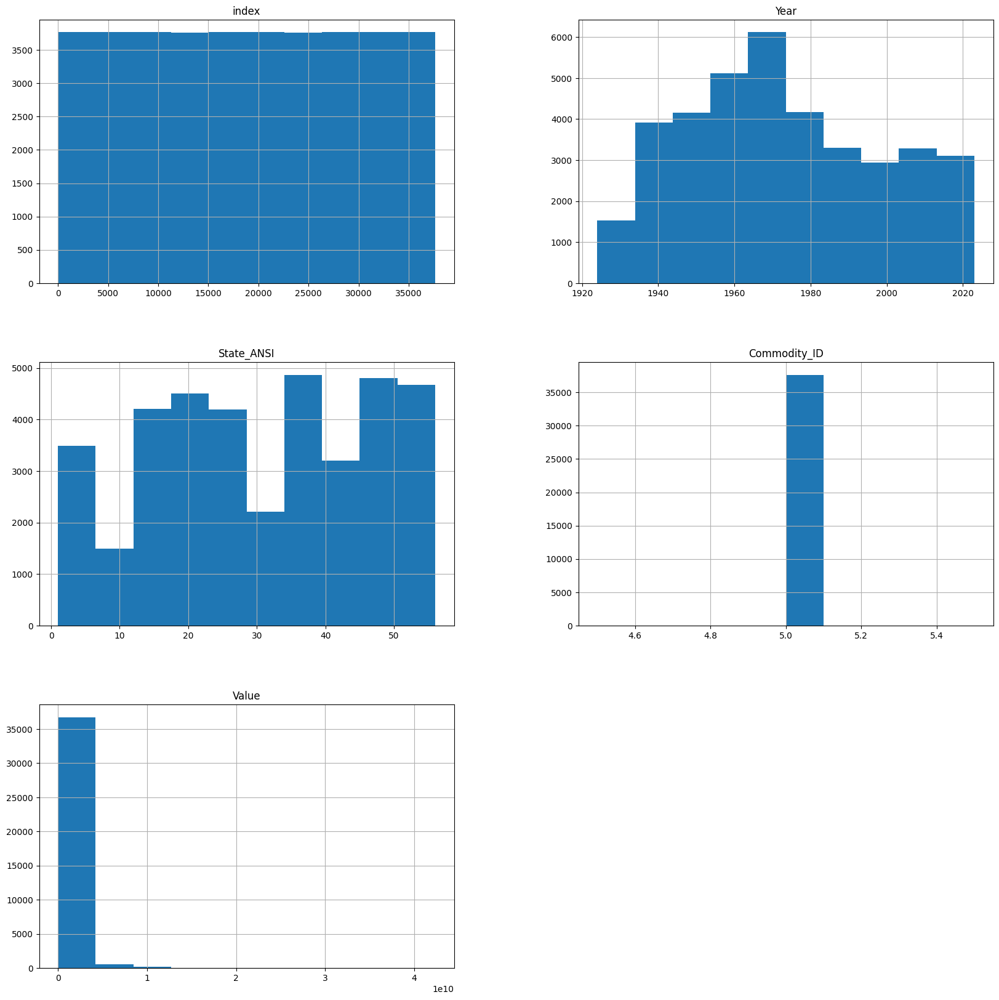

In [109]:
milk_production.hist(figsize=(20,20))

In [110]:
milk_production[['Value', 'State_ANSI', 'Year']].sort_values(by='Value', ascending=False)

,Value,State_ANSI,Year
3065,42339000000,6,2014
748,41861000000,6,2021
3729,41801000000,6,2012
411,41787000000,6,2022
4055,41462000000,6,2011
...,...,...,...
19169,1330000,2,1969
18819,1300000,2,1970
17819,1280000,2,1971
18219,1260000,2,1971


<Axes: >

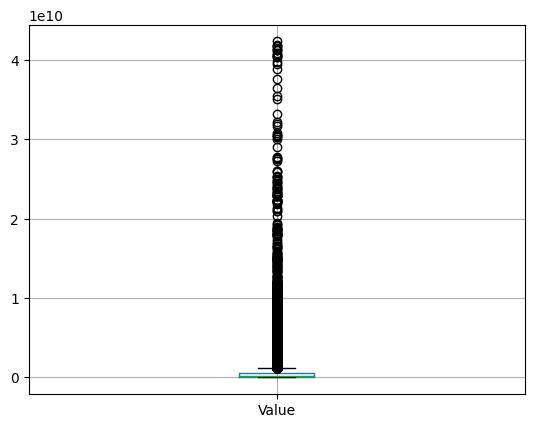

In [111]:
milk_production.boxplot('Value')

In [112]:
%%sql

PRAGMA table_info(milk_production);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,Year,INTEGER,0,None,0
2,Period,TEXT,0,None,0
3,Geo_Level,TEXT,0,None,0
4,State_ANSI,REAL,0,None,0
5,Commodity_ID,INTEGER,0,None,0
6,Domain,TEXT,0,None,0
7,Value,INTEGER,0,None,0


# state lookup

In [113]:
state_lookup=pd.read_csv('state_lookup.csv')

In [114]:
state_lookup.to_sql('state_lookup',
                         cnn,
                        if_exists= 'replace')

50

In [115]:
%%sql 

Select * 

From state_lookup

 * sqlite:///farm.db
Done.


index,State,State_ANSI
0,ALABAMA,1
1,ALASKA,2
2,ARIZONA,4
3,ARKANSAS,5
4,CALIFORNIA,6
5,COLORADO,8
6,CONNECTICUT,9
7,DELAWARE,10
8,FLORIDA,12
9,GEORGIA,13


In [116]:
%%sql

PRAGMA table_info(state_lookup);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,State,TEXT,0,None,0
2,State_ANSI,INTEGER,0,None,0


# yogurt production

In [117]:
yogurt_production=pd.read_csv('yogurt_production.csv')

In [118]:
yogurt_production.to_sql('yogurt_production',
                         cnn,
                        if_exists= 'replace')

149

In [119]:
%%sql 

Select * 

From yogurt_production

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,2022,YEAR,STATE,6,4,TOTAL,"377,839,000"
1,2022,YEAR,STATE,36,4,TOTAL,"793,256,000"
2,2021,YEAR,STATE,6,4,TOTAL,"374,637,000"
3,2021,YEAR,STATE,36,4,TOTAL,"774,881,000"
4,2020,YEAR,STATE,6,4,TOTAL,"354,906,000"
5,2020,YEAR,STATE,36,4,TOTAL,"722,922,000"
6,2019,YEAR,STATE,6,4,TOTAL,"373,760,000"
7,2019,YEAR,STATE,36,4,TOTAL,"679,190,000"
8,2019,YEAR,STATE,48,4,TOTAL,"37,769,000"
9,2018,YEAR,STATE,6,4,TOTAL,"415,150,000"


In [120]:
result5 = %sql Select * From yogurt_production
yogurt_production = result5.DataFrame()

 * sqlite:///farm.db
Done.


In [121]:
yogurt_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,0,2022,YEAR,STATE,6,4,TOTAL,"377,839,000"
1,1,2022,YEAR,STATE,36,4,TOTAL,"793,256,000"
2,2,2021,YEAR,STATE,6,4,TOTAL,"374,637,000"
3,3,2021,YEAR,STATE,36,4,TOTAL,"774,881,000"
4,4,2020,YEAR,STATE,6,4,TOTAL,"354,906,000"


In [122]:
yogurt_production.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 149 entries, 0 to 148
Data columns (total 8 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   index         149 non-null    int64 
 1   Year          149 non-null    int64 
 2   Period        149 non-null    object
 3   Geo_Level     149 non-null    object
 4   State_ANSI    149 non-null    int64 
 5   Commodity_ID  149 non-null    int64 
 6   Domain        149 non-null    object
 7   Value         149 non-null    object
dtypes: int64(4), object(4)
memory usage: 9.4+ KB


In [123]:
yogurt_production.nunique()

index           149
Year             29
Period            1
Geo_Level         1
State_ANSI       15
Commodity_ID      1
Domain            1
Value           146
dtype: int64

In [124]:
yogurt_production[yogurt_production.duplicated()]

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value


In [125]:
yogurt_production.isna().sum()

index           0
Year            0
Period          0
Geo_Level       0
State_ANSI      0
Commodity_ID    0
Domain          0
Value           0
dtype: int64

In [126]:
yogurt_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,149,74,43,0,37,74,111,148
Year,149,"2,002",9,"1,990","1,994","2,002","2,008","2,022"
State_ANSI,149,31,17,6,17,36,47,55
Commodity_ID,149,4,0,4,4,4,4,4


In [127]:
yogurt_production['Value']= pd.to_numeric(yogurt_production['Value'].str.replace(',',''), errors = 'coerce')

In [128]:
yogurt_production.head()

,index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value
0,0,2022,YEAR,STATE,6,4,TOTAL,"377,839,000"
1,1,2022,YEAR,STATE,36,4,TOTAL,"793,256,000"
2,2,2021,YEAR,STATE,6,4,TOTAL,"374,637,000"
3,3,2021,YEAR,STATE,36,4,TOTAL,"774,881,000"
4,4,2020,YEAR,STATE,6,4,TOTAL,"354,906,000"


In [129]:
yogurt_production.describe().T

,count,mean,std,min,25%,50%,75%,max
index,149,74,43,0,37,74,111,148
Year,149,"2,002",9,"1,990","1,994","2,002","2,008","2,022"
State_ANSI,149,31,17,6,17,36,47,55
Commodity_ID,149,4,0,4,4,4,4,4
Value,147,"177,199,088","200,116,623","23,000","17,002,500","105,402,000","247,226,500","793,256,000"


In [130]:
yogurt_production.to_sql('yogurt_production', cnn, index=False, if_exists='replace')

149

array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'Year'}>],
       [<Axes: title={'center': 'State_ANSI'}>,
        <Axes: title={'center': 'Commodity_ID'}>],
       [<Axes: title={'center': 'Value'}>, <Axes: >]], dtype=object)

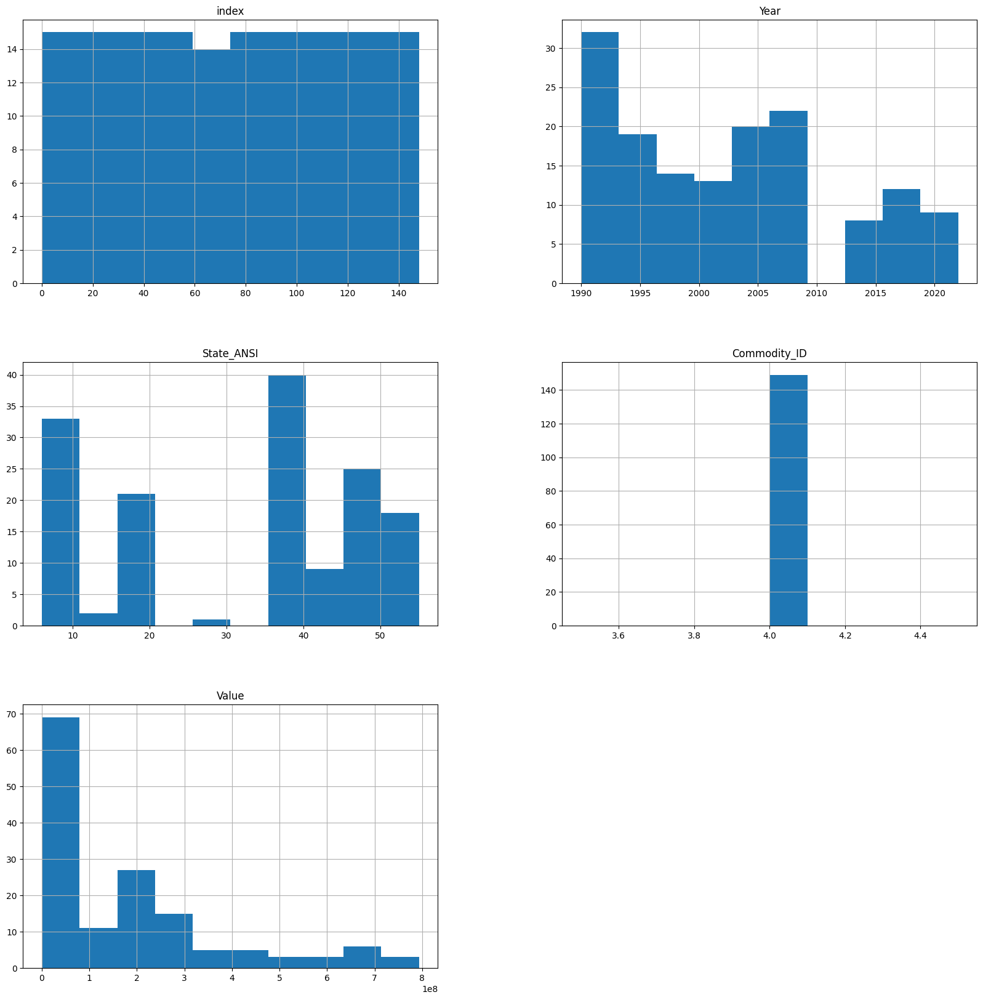

In [131]:
yogurt_production.hist(figsize=(20,20))

In [132]:
yogurt_production[['Value', 'State_ANSI', 'Year']].sort_values(by='Value', ascending=False)

,Value,State_ANSI,Year
1,"793,256,000",36,2022
3,"774,881,000",36,2021
5,"722,922,000",36,2020
14,"706,923,000",36,2017
10,"691,044,000",36,2018
...,...,...,...
107,"26,000",38,1995
122,"25,000",38,1993
91,"23,000",38,1998
25,NaN,6,2014


<Axes: >

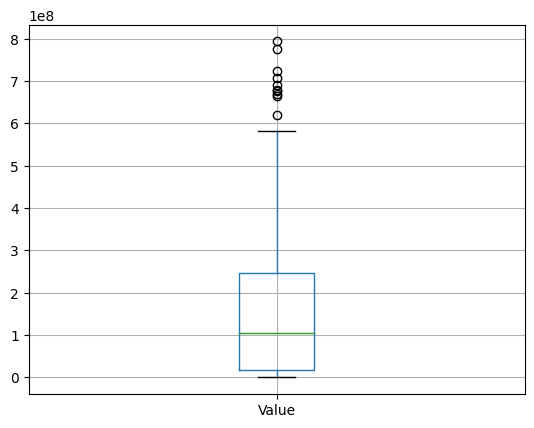

In [133]:
yogurt_production.boxplot('Value')

In [134]:
%%sql

PRAGMA table_info(yogurt_production);

 * sqlite:///farm.db
Done.


cid,name,type,notnull,dflt_value,pk
0,index,INTEGER,0,None,0
1,Year,INTEGER,0,None,0
2,Period,TEXT,0,None,0
3,Geo_Level,TEXT,0,None,0
4,State_ANSI,INTEGER,0,None,0
5,Commodity_ID,INTEGER,0,None,0
6,Domain,TEXT,0,None,0
7,Value,REAL,0,None,0


## Scenario:

1.
Question 1
Can you find out the total milk production for 2023? Your manager wants this information for the yearly report.

What is the total milk production for 2023?

In [137]:
%%sql

Select Sum(Value)
From milk_production
where Year = 2023

 * sqlite:///farm.db
Done.


Sum(Value)
91812000000


2.
Question 2
Which states had cheese production greater than 100 million in April 2023? The Cheese Department wants to focus their marketing efforts there. 

How many states are there?

In [148]:
%%sql

Select *
From cheese_production
Where Value2 > 100000000
And Year = 2023
And Period = 'APR'

 * sqlite:///farm.db
Done.


index,Year,Period,Geo_Level,State_ANSI,Commodity_ID,Domain,Value2
0,2023,APR,STATE,6.0,6,TOTAL,208807000
9,2023,APR,STATE,None,6,TOTAL,215206000
13,2023,APR,STATE,55.0,6,TOTAL,289699000


3.
Question 3
Your manager wants to know how coffee production has changed over the years. 

What is the total value of coffee production for 2011?

In [139]:
%%sql

Select Sum(value)
From coffee_production
Where Year = 2011

 * sqlite:///farm.db
Done.


Sum(value)
7600000


4.
Question 4
There's a meeting with the Honey Council next week. Find the average honey production for 2022 so you're prepared.

In [140]:
%%sql

Select AVG(value)
From honey_production
Where Year = 2022

 * sqlite:///farm.db
Done.


AVG(value)
3133275.0


5.
Question 5
The State Relations team wants a list of all states names with their corresponding ANSI codes. Can you generate that list?

What is the State_ANSI code for Florida?

In [141]:
%%sql 

Select * 
From state_lookup

 * sqlite:///farm.db
Done.


index,State,State_ANSI
0,ALABAMA,1
1,ALASKA,2
2,ARIZONA,4
3,ARKANSAS,5
4,CALIFORNIA,6
5,COLORADO,8
6,CONNECTICUT,9
7,DELAWARE,10
8,FLORIDA,12
9,GEORGIA,13


6.
Question 6
For a cross-commodity report, can you list all states with their cheese production values, even if they didn't produce any cheese in April of 2023?

What is the total for NEW JERSEY?

In [150]:
%%sql 

Select 
    cp.Value2 AS cheese_prod_value, 
    cp.State_ANSI AS cheese_State_ANSI, 
    cp.Year AS cheese_prod_year,
    cp.Period AS cheese_prod_period,
    sl.State_ANSI AS SL_State_ANSI, 
    sl.State AS State
From cheese_production cp
Left Join state_lookup sl on
cp.State_ANSI = sl.State_ANSI
Where 
    cp.Year = 2023 AND
    cp.Period = 'APR' AND
    sl.State = 'NEW JERSEY'

 * sqlite:///farm.db
Done.


cheese_prod_value,cheese_State_ANSI,cheese_prod_year,cheese_prod_period,SL_State_ANSI,State
4889000,34.0,2023,APR,34,NEW JERSEY


7.
Question 7
Can you find the total yogurt production for states in the year 2022 which also have cheese production data from 2023? This will help the Dairy Division in their planning.

In [142]:
%%sql 

Select 
    SUM(yp.Value)
From 
    yogurt_production yp
Where 
    yp.Year = 2022
AND 
    yp.State_Ansi IN (
        SELECT DISTINCT 
            cp.State_Ansi 
        From 
            cheese_production cp
        Where cp.Year = 2023
                        )

 * sqlite:///farm.db
Done.


SUM(yp.Value)
1171095000.0


8.
Question 8
List all states from state_lookup that are missing from milk_production in 2023.

How many states are there?

In [143]:
%%sql 

Select
    DISTINCT Count(State_ANSI)
From state_lookup

 * sqlite:///farm.db
Done.


Count(State_ANSI)
50


In [168]:
%%sql

SELECT s.State
FROM state_lookup s
LEFT JOIN milk_production m ON s.State_ANSI = m.State_ANSI AND m.Year = 2023
WHERE m.State_ANSI IS NULL;

 * sqlite:///farm.db
Done.


State
ALABAMA
ALASKA
ARKANSAS
CONNECTICUT
DELAWARE
HAWAII
KENTUCKY
LOUISIANA
MAINE
MARYLAND


In [152]:
%%sql 

Select
    DISTINCT Count(State_ANSI)
From
(Select
    mp.Value,
    sl.State,
    mp.State_ANSI,
    mp.Period, 
    mp.Year
From 
    milk_production mp 
Left Join 
    state_lookup sl on
    mp.State_ANSI = sl.State_ANSI
Where 
    Year = 2023
ORDER BY
    mp.State_ANSI DESC)

 * sqlite:///farm.db
Done.


Count(State_ANSI)
120


9.
Question 9
List all states with their cheese production values, including states that didn't produce any cheese in April 2023.

Did Delaware produce any cheese in April 2023?

In [151]:
%%sql 

Select
    cp.Value2 AS cheese_prod_value,
    sl.State AS State,
    cp.Year AS cheese_prod_year,
    cp.Period,
    sl.StatE_ANSI
From 
    cheese_production cp 
Left Join 
    state_lookup sl on
    cp.State_ANSI = sl.State_ANSI
Where 
cp.Period = 'APR'
AND
cp.Year = 2023

 * sqlite:///farm.db
Done.


cheese_prod_value,State,cheese_prod_year,Period,State_ANSI
208807000,CALIFORNIA,2023,APR,6
86452000,IDAHO,2023,APR,16
5068000,ILLINOIS,2023,APR,17
31512000,IOWA,2023,APR,19
69728000,MINNESOTA,2023,APR,27
4889000,NEW JERSEY,2023,APR,34
79038000,NEW MEXICO,2023,APR,35
66256000,NEW YORK,2023,APR,36
20510000,OHIO,2023,APR,39
215206000,None,2023,APR,None


10.
Question 10
Find the average coffee production for all years where the honey production exceeded 1 million.

In [146]:
%%sql 

Select
    AVG(c.Value)
From 
    coffee_production c 
Where 
    c.Year IN (
                Select 
                    h.Year 
                From
                    honey_production h 
                Where h.Value > 1000000)

 * sqlite:///farm.db
Done.


AVG(c.Value)
6426666.666666667
